<a href="https://colab.research.google.com/github/QiyuLiu21/L04/blob/master/Regressionhousinganalysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
from pylab import rcParams
# PyLab is a module that belongs to the Python mathematics library Matplotlib. 
# PyLab combines the numerical module numpy with the graphical plotting module pyplot.
# rcParams: An instance of RcParams for handling default Matplotlib values.

import matplotlib.pyplot as plt
import matplotlib.animation as animation
# The easiest way to make a live animation in matplotlib is to use one of the Animation classes.

from matplotlib import rc
# Set the current rcParams. group is the grouping for the rc

import unittest
# unit testing frameworks supports test automation, sharing of setup and shutdown code for tests, 
# aggregation of tests into collections, and independence of the tests from the reporting framework.

%matplotlib inline

sns.set(style='whitegrid', palette='muted', font_scale=1.5)

sns.set()

rcParams['figure.figsize'] = 14, 8

RANDOM_SEED = 42

np.random.seed(RANDOM_SEED)

def run_tests():
  unittest.main(argv=[''], verbosity=1, exit=False)

# Load the data.

Data House Prices: Advanced Regression Techniques

In [ ]:
!wget https://raw.githubusercontent.com/Data-Science-FMI/ml-from-scratch-2019/master/data/house_prices_train.csv
# Using wget module to download the data from website.

--2021-01-17 01:46:22--  https://raw.githubusercontent.com/Data-Science-FMI/ml-from-scratch-2019/master/data/house_prices_train.csv
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 460676 (450K) [text/plain]
Saving to: ‘house_prices_train.csv.1’

house_prices_train. 100%[===================>] 449.88K  --.-KB/s    in 0.02s   

2021-01-17 01:46:22 (18.2 MB/s) - ‘house_prices_train.csv.1’ saved [460676/460676]



In [ ]:
df_train = pd.read_csv('house_prices_train.csv')
# Reading the data as pandas.

# Data exploration

In [ ]:
df_train['SalePrice'].describe()
# Describing the SalePrice of the df_train.

count      1460.000000
mean     180921.195890
std       79442.502883
min       34900.000000
25%      129975.000000
50%      163000.000000
75%      214000.000000
max      755000.000000
Name: SalePrice, dtype: float64

In [ ]:
df_train.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,...,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,...,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,...,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,...,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,...,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,...,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


/usr/local/lib/python3.6/dist-packages/seaborn/distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


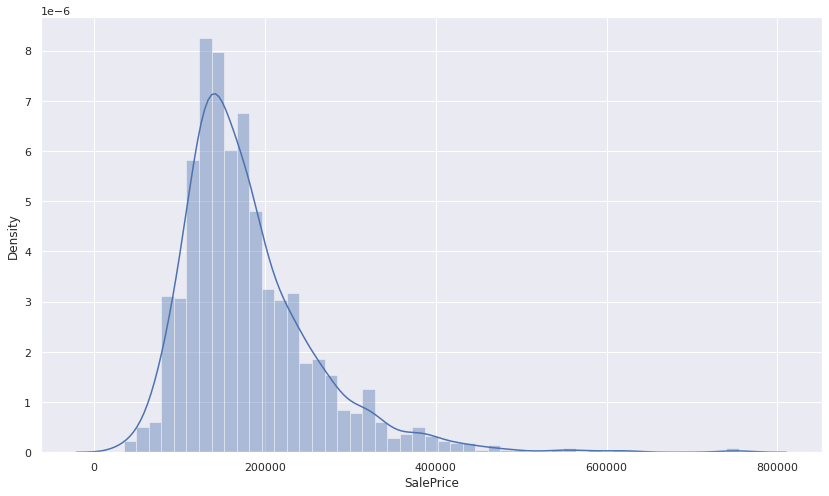

In [ ]:
sns.distplot(df_train['SalePrice']);
# Shows the distribution of SalePrice.
# This function combines the matplotlib hist function with the seaborn kdeplot() and rugplot() functions.

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


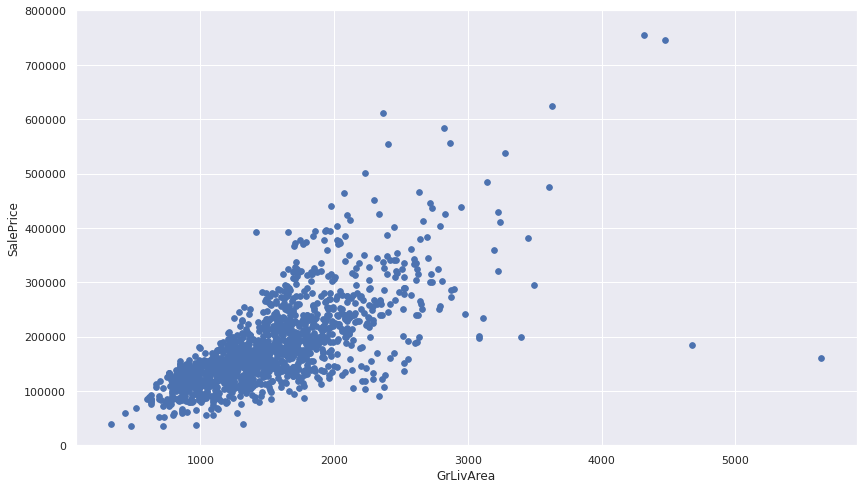

In [ ]:
var = 'GrLivArea'
# Chosing GrLivArea as the independent variable.

data = pd.concat([df_train['SalePrice'], df_train[var]], axis=1)
# Concatenate  df_train['SalePrice'] and df_train[var] along the particular axis with optional set logic along the other axes.

data.plot.scatter(x=var, y='SalePrice', ylim=(0,800000), s=32);
# Get the scatter plot of x is GrLivArea and y is SalePrice. The limitation of y value is 800000. 

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


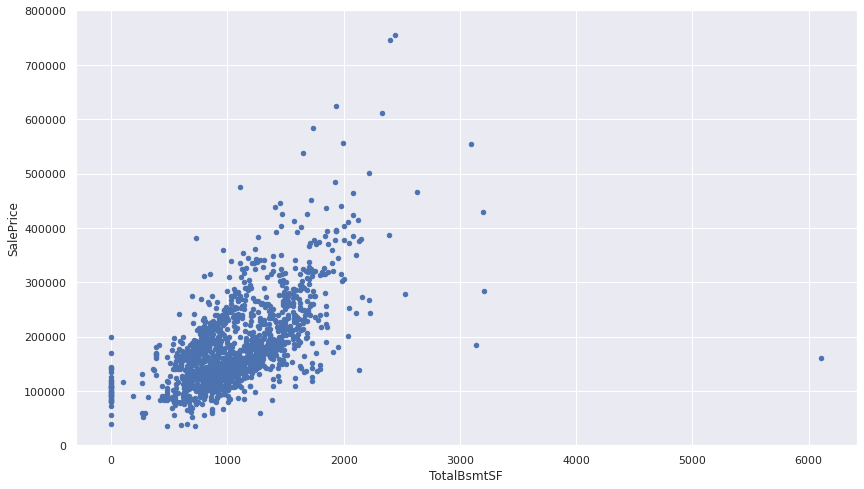

In [ ]:
var = 'TotalBsmtSF'
# Chosing TotalBsmtSF as the independent variable.

data = pd.concat([df_train['SalePrice'], df_train[var]], axis=1)
# Concatenate  df_train['SalePrice'] and df_train[var] along the particular axis with optional set logic along the other axes.

data.plot.scatter(x=var, y='SalePrice', ylim=(0,800000));
# Get the scatter plot of x is TotalBsmtSF and y is SalePrice. The limitation of y value is 800000. 

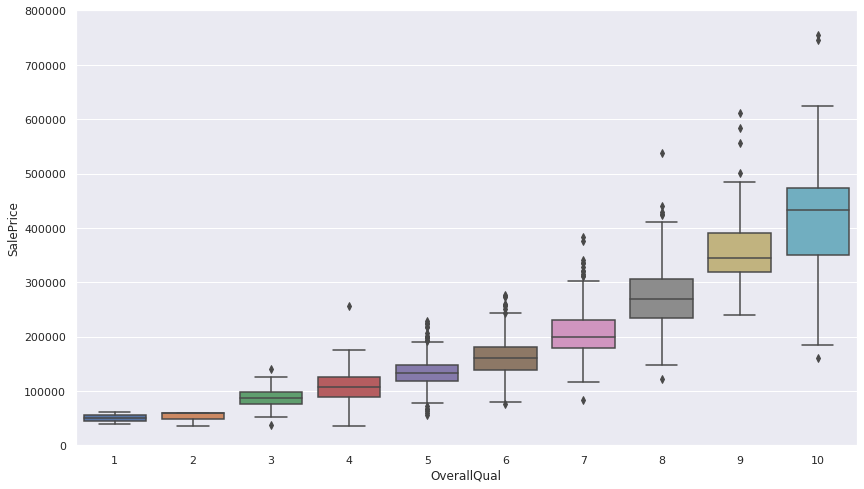

In [ ]:
var = 'OverallQual'
# Chosing OverallQual as the independent variable.

data = pd.concat([df_train['SalePrice'], df_train[var]], axis=1)
# Concatenate  df_train['SalePrice'] and df_train[var] along the particular axis with optional set logic along the other axes.

f, ax = plt.subplots(figsize=(14, 8))
# pyplot.subplots creates a figure and a grid of subplots with a single call, 
# while providing reasonable control over how the individual plots are created.
fig = sns.boxplot(x=var, y="SalePrice", data=data)
# Get the boxplot of x is OverallQual and y is SalePrice. 

fig.axis(ymin=0, ymax=800000);

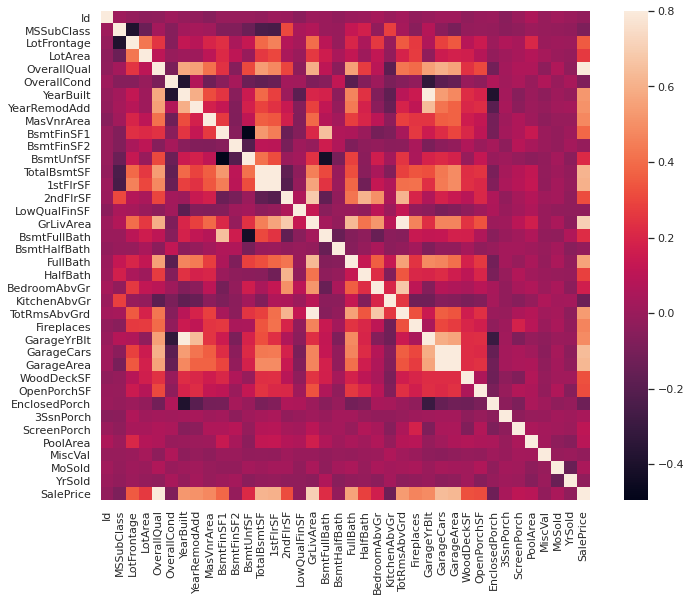

In [ ]:
corrmat = df_train.corr()
# The correlation coefficient of all the variables in the df_train data.

f, ax = plt.subplots(figsize=(12, 9))
# pyplot.subplots creates a figure and a grid of subplots with a single call, 
# while providing reasonable control over how the individual plots are created.

sns.heatmap(corrmat, vmax=.8, square=True);
# Plot rectangular data as a color-encoded matrix using corrmat.

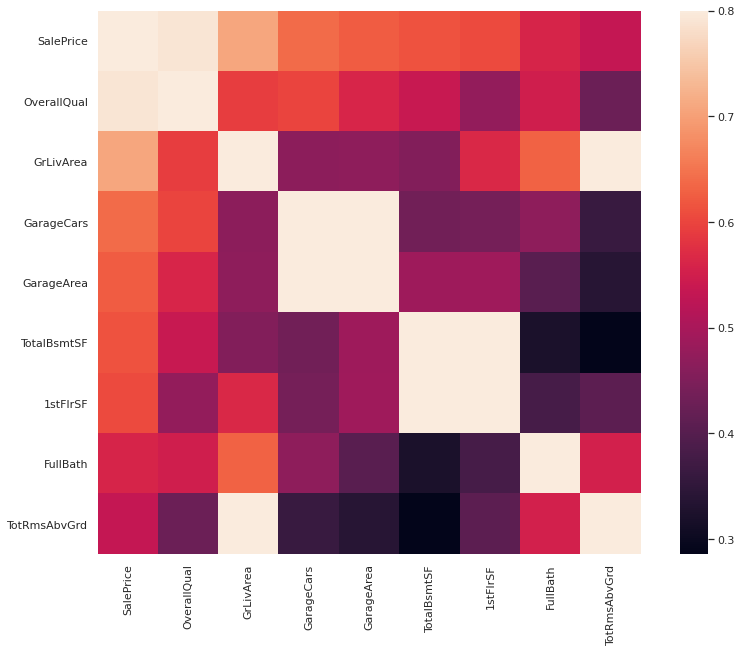

In [ ]:
k = 9 #number of variables for heatmap

cols = corrmat.nlargest(k, 'SalePrice')['SalePrice'].index
# Return the largest 9 elements which reflect the SalePrice.

f, ax = plt.subplots(figsize=(14, 10))
# # pyplot.subplots creates a figure and a grid of subplots with a single call, 
# while providing reasonable control over how the individual plots are created.

sns.heatmap(df_train[cols].corr(), vmax=.8, square=True);
# Plot rectangular data as a color-encoded matrix using these 9 elements.

/usr/local/lib/python3.6/dist-packages/seaborn/axisgrid.py:1969: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


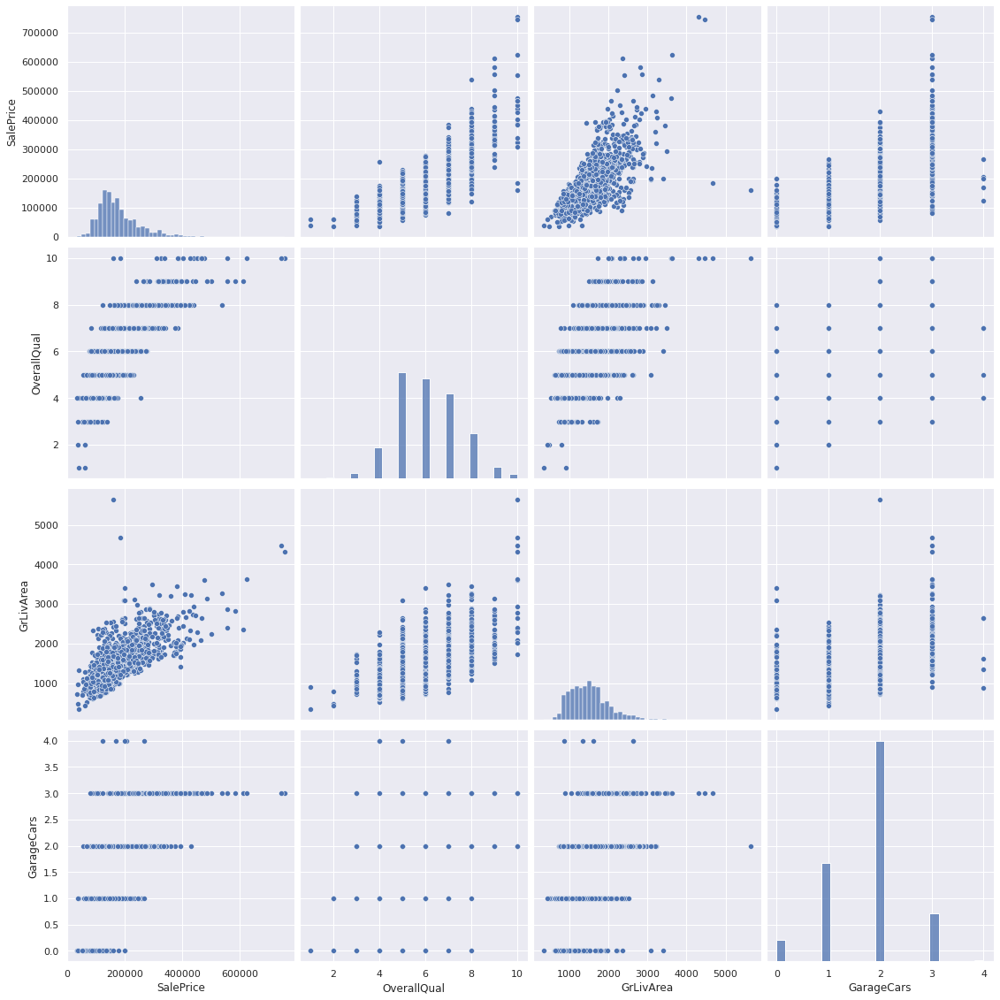

In [ ]:
cols = ['SalePrice', 'OverallQual', 'GrLivArea', 'GarageCars']
# Choosing columns SalePrice, OverallQual, GrLivArea and GarageCars.

sns.pairplot(df_train[cols], size = 4);
# Plot pairwise relationships in the df_train data. Every line shows 4 graphys.

# Do we have missing data?

In [ ]:
total = df_train.isnull().sum().sort_values(ascending=False)
# Calculate the total null data for every categaried and using descending order to shows.

percent = (df_train.isnull().sum()/df_train.isnull().count()).sort_values(ascending=False)
# Calculate the percentage of total null data in a specific categaries.

missing_data = pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])
# Concatenate  total and percentage along the particular axis with optional set logic along the other axes.

missing_data.head(20)

,Total,Percent
PoolQC,1453,0.995205
MiscFeature,1406,0.963014
Alley,1369,0.937671
Fence,1179,0.807534
FireplaceQu,690,0.472603
LotFrontage,259,0.177397
GarageCond,81,0.055479
GarageType,81,0.055479
GarageYrBlt,81,0.055479
GarageFinish,81,0.055479


# Predicting the sale price
Preparing the data
Feature scaling
We will do a little preprocessing to our data using the following formula (standardization):

𝑥′=𝑥−𝜇𝜎 

where  𝜇  is the population mean and  𝜎  is the standard deviation.



Source: Andrew Ng

In [ ]:
x = df_train['GrLivArea']
# Choosing GrLivArea as the x variable.

y = df_train['SalePrice']
# Choosing SalePrice as the y variable.

x = (x - x.mean()) / x.std()

x = np.c_[np.ones(x.shape[0]), x] 

In [ ]:
x.shape

(1460, 2)

# Linear Regression


Source: MyBookSucks

Linear regression models assume that the relationship between a dependent continuous variable  𝑌  and one or more explanatory (independent) variables  𝑋  is linear (that is, a straight line). It’s used to predict values within a continuous range, (e.g. sales, price) rather than trying to classify them into categories (e.g. cat, dog). Linear regression models can be divided into two main types:

Simple Linear Regression
Simple linear regression uses a traditional slope-intercept form, where  𝑎  and  𝑏  are the coefficients that we try to “learn” and produce the most accurate predictions.  𝑋  represents our input data and  𝑌  is our prediction.

𝑌=𝑏𝑋+𝑎 



Source: SPSS tutorials

Multivariable Regression
A more complex, multi-variable linear equation might look like this, where w represents the coefficients, or weights, our model will try to learn.

𝑌(𝑥1,𝑥2,𝑥3)=𝑤1𝑥1+𝑤2𝑥2+𝑤3𝑥3+𝑤0 

The variables  𝑥1,𝑥2,𝑥3  represent the attributes, or distinct pieces of information, we have about each observation.

# Loss function
Given our Simple Linear Regression equation:

𝑌=𝑏𝑋+𝑎 

We can use the following cost function to find the coefficients:

Mean Squared Error (MSE) Cost Function
The MSE is defined as:

𝑀𝑆𝐸=𝐽(𝑊)=1𝑚∑𝑖=1𝑚(𝑦(𝑖)−ℎ𝑤(𝑥(𝑖)))2 

where

ℎ𝑤(𝑥)=𝑔(𝑤𝑇𝑥) 

The MSE measures how much the average model predictions vary from the correct values. The number is higher when the model is performing "bad" on the training set.

The first derivative of MSE is given by:

𝑀𝑆𝐸′=𝐽′(𝑊)=2𝑚∑𝑖=1𝑚(ℎ𝑤(𝑥(𝑖))−𝑦(𝑖)) 

One Half Mean Squared Error (OHMSE)
We will apply a small modification to the MSE - multiply by  12  so when we take the derivative, the 2s cancel out:

𝑂𝐻𝑀𝑆𝐸=𝐽(𝑊)=12𝑚∑𝑖=1𝑚(𝑦(𝑖)−ℎ𝑤(𝑥(𝑖)))2 

The first derivative of OHMSE is given by:

𝑂𝐻𝑀𝑆𝐸′=𝐽′(𝑊)=1𝑚∑𝑖=1𝑚(ℎ𝑤(𝑥(𝑖))−𝑦(𝑖))

In [ ]:
def loss(h, y):
# Loss functions are used to understand and improve machine learning algorithms. 

  sq_error = (h - y)**2
# Square error is the square of the difference between the actual and the predicted values.

  n = len(y)
  return 1.0 / (2*n) * sq_error.sum()

In [ ]:
class TestLoss(unittest.TestCase): ######## I have questions of this part!!!

  def test_zero_h_zero_y(self):
    self.assertAlmostEqual(loss(h=np.array([0]), y=np.array([0])), 0)

  def test_one_h_zero_y(self):
    self.assertAlmostEqual(loss(h=np.array([1]), y=np.array([0])), 0.5)

  def test_two_h_zero_y(self):
    self.assertAlmostEqual(loss(h=np.array([2]), y=np.array([0])), 2)
    
  def test_zero_h_one_y(self):
    self.assertAlmostEqual(loss(h=np.array([0]), y=np.array([1])), 0.5)
    
  def test_zero_h_two_y(self):
    self.assertAlmostEqual(loss(h=np.array([0]), y=np.array([2])), 2)

In [ ]:
run_tests()

......
----------------------------------------------------------------------
Ran 6 tests in 1.308s

OK


In [ ]:
class LinearRegression:
  
  def predict(self, X):
    return np.dot(X, self._W)
  
  def _gradient_descent_step(self, X, targets, lr):

    predictions = self.predict(X)
    
    error = predictions - targets
    gradient = np.dot(X.T,  error) / len(X)

    self._W -= lr * gradient
      
  def fit(self, X, y, n_iter=100000, lr=0.01):

    self._W = np.zeros(X.shape[1])

    self._cost_history = []
    self._w_history = [self._W]
    for i in range(n_iter):
      
        prediction = self.predict(X)
        cost = loss(prediction, y)
        
        self._cost_history.append(cost)
        
        self._gradient_descent_step(x, y, lr)
        
        self._w_history.append(self._W.copy())
    return self

In [ ]:
class TestLinearRegression(unittest.TestCase):

    def test_find_coefficients(self):
      clf = LinearRegression()
      clf.fit(x, y, n_iter=2000, lr=0.01)
      np.testing.assert_array_almost_equal(clf._W, np.array([180921.19555322,  56294.90199925]))

In [ ]:
run_tests()

......
----------------------------------------------------------------------
Ran 6 tests in 1.315s

OK


In [ ]:
clf = LinearRegression()
clf.fit(x, y, n_iter=2000, lr=0.01)

In [ ]:
clf._W

array([180921.19555322,  56294.90199925])

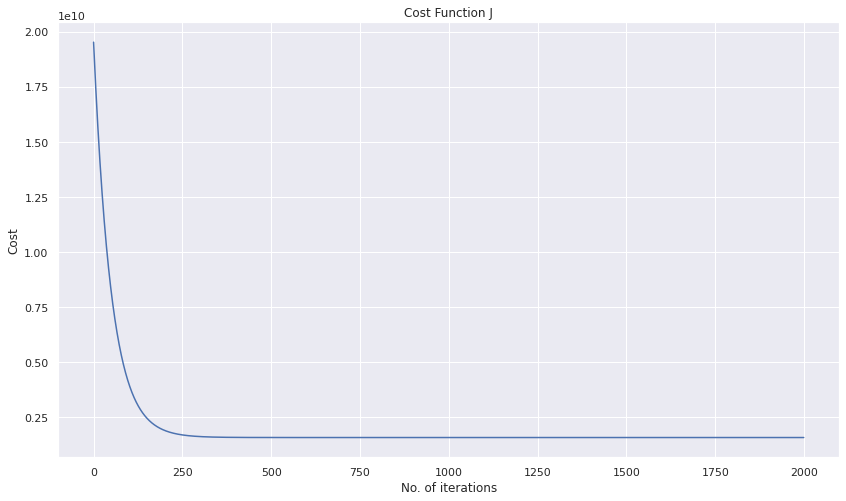

In [ ]:
plt.title('Cost Function J')
# Put Cost Function as the title of the graphy.

plt.xlabel('No. of iterations')
# Using No. of iterations as the x label.

plt.ylabel('Cost')
# Using Cost as the y label.

plt.plot(clf._cost_history)
# Using the data of clf._cost_history to plot the graphy.

plt.show()

In [ ]:
clf._cost_history[-1]
# Show the last data of clf._cost_history. 

1569921604.8332634

In [ ]:
#Animation

#Set the plot up,
fig = plt.figure()
# Set the figure.

ax = plt.axes()
# Set the axes.

plt.title('Sale Price vs Living Area')
# Using Sale Price vs Living Area as the title.

plt.xlabel('Living Area in square feet (normalised)')
# Using Living Area in square feet (normalised) as the x label.

plt.ylabel('Sale Price ($)')
# Using Sale Price ($) as the y label.

plt.scatter(x[:,1], y)
# 
line, = ax.plot([], [], lw=2, color='red')
annotation = ax.text(-1, 700000, '')
annotation.set_animated(True)
plt.close()

#Generate the animation data,
def init():
    line.set_data([], [])
    annotation.set_text('')
    return line, annotation

# animation function.  This is called sequentially
def animate(i):
    x = np.linspace(-5, 20, 1000)
    y = clf._w_history[i][1]*x + clf._w_history[i][0]
    line.set_data(x, y)
    annotation.set_text('Cost = %.2f e10' % (clf._cost_history[i]/10000000000))
    return line, annotation

anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=300, interval=10, blit=True)

rc('animation', html='jshtml')

anim

# Multivariable Linear Regression
Let's use more of the available data to build a Multivariable Linear Regression model and see whether or not that will improve our OHMSE error:

In [ ]:
x = df_train[['OverallQual', 'GrLivArea', 'GarageCars']]

x = (x - x.mean()) / x.std()
x = np.c_[np.ones(x.shape[0]), x] 

clf = LinearRegression()
clf.fit(x, y, n_iter=2000, lr=0.01)

In [ ]:
clf._W

array([180921.19555322,  37478.604254  ,  26631.93830568,  15921.22581327])

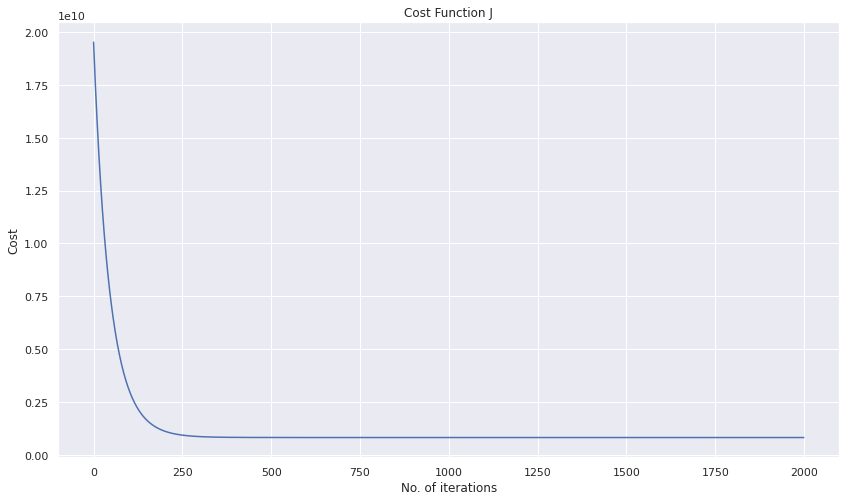

In [ ]:
plt.title('Cost Function J')
plt.xlabel('No. of iterations')
plt.ylabel('Cost')
plt.plot(clf._cost_history)
plt.show()

In [ ]:
clf._cost_history[-1]

822817042.8437098